<a href="https://colab.research.google.com/github/hoangnuthuphuong/final_project-a/blob/main/Autoencoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###CHUẨN BỊ

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Xác định đường dẫn đến file ZIP
zip_path = '/content/drive/MyDrive/DOANTOTNGHIEP/DATA_FULL.zip'

# Giải nén tập tin vào thư mục /content/dataset
!unzip -q {zip_path} -d /content/dataset

In [ ]:
import os
import shutil

# Đường dẫn thư mục gốc chứa dữ liệu
base_data_path = '/content/dataset/DATA_FULL'

# Đường dẫn thư mục đích
destination_dir = '/content/dataset/data'

# Tạo thư mục đích nếu nó chưa tồn tại
os.makedirs(destination_dir, exist_ok=True)
print(f"Thư mục '{destination_dir}' đã được tạo hoặc đã tồn tại.")

# Danh sách các thư mục nguồn cần sao chép
source_folders = ['OK1366', 'OK_1120']

for folder_name in source_folders:
    source_path = os.path.join(base_data_path, folder_name)
    print(f"Đang sao chép dữ liệu từ '{source_path}' vào '{destination_dir}'...")

    # Kiểm tra xem thư mục nguồn có tồn tại không trước khi sao chép
    if os.path.exists(source_path) and os.path.isdir(source_path):
        # Sao chép tất cả nội dung từ thư mục nguồn vào thư mục đích
        for item_name in os.listdir(source_path):
            item_path = os.path.join(source_path, item_name)
            # Sử dụng shutil.copy để sao chép file hoặc shutil.copytree để sao chép thư mục con
            if os.path.isfile(item_path):
                shutil.copy(item_path, destination_dir)
            elif os.path.isdir(item_path):
                # Nếu thư mục con đã tồn tại trong đích, hợp nhất nội dung
                # Nếu không, sao chép toàn bộ thư mục con
                dest_item_path = os.path.join(destination_dir, item_name)
                if os.path.exists(dest_item_path):
                    # Nếu thư mục con đã tồn tại, hãy hợp nhất. Điều này phức tạp hơn copytree.
                    # Để đơn giản, nếu yêu cầu là copy tất cả dữ liệu, ta có thể ghi đè hoặc bỏ qua.
                    # Với yêu cầu 'copy tất cả dữ liệu', giả định ghi đè hoặc copy những gì chưa có.
                    # Để tránh lỗi nếu có file trùng, có thể dùng copy2 hoặc kiểm tra trước.
                    # Hiện tại, shutil.copy sẽ ghi đè nếu file có cùng tên.
                    # Với thư mục, ta cần duyệt và sao chép từng file nếu muốn hợp nhất.
                    # Cách đơn giản hơn là sao chép các file riêng lẻ chứ không phải cả thư mục con lớn.
                    # Giả sử trong OK1366 và OK_1120 là các file ảnh, không phải thư mục lồng nhau.
                    print(f"Cảnh báo: Thư mục con '{item_name}' đã tồn tại trong đích. Bỏ qua hoặc hợp nhất thủ công.")
                else:
                    shutil.copytree(item_path, dest_item_path)
        print(f"Đã sao chép xong từ '{source_path}'.")
    else:
        print(f"Lỗi: Thư mục nguồn '{source_path}' không tồn tại hoặc không phải là thư mục.")

print(f"Hoàn tất quá trình sao chép dữ liệu vào '{destination_dir}'.")
# In ra số lượng file trong thư mục đích để xác nhận
print(f"Tổng số mục trong '{destination_dir}': {len(os.listdir(destination_dir))}")

Thư mục '/content/dataset/data' đã được tạo hoặc đã tồn tại.
Đang sao chép dữ liệu từ '/content/dataset/DATA_FULL/OK1366' vào '/content/dataset/data'...
Đã sao chép xong từ '/content/dataset/DATA_FULL/OK1366'.
Đang sao chép dữ liệu từ '/content/dataset/DATA_FULL/OK_1120' vào '/content/dataset/data'...
Đã sao chép xong từ '/content/dataset/DATA_FULL/OK_1120'.
Hoàn tất quá trình sao chép dữ liệu vào '/content/dataset/data'.
Tổng số mục trong '/content/dataset/data': 2486


#KIỂM THỬ


In [ ]:
# Xác định đường dẫn đến file ZIP
zip_path = '/content/drive/MyDrive/DOANTOTNGHIEP/DATA_TEST.zip'

# Giải nén tập tin vào thư mục /content/dataset
!unzip -q {zip_path} -d /content/dataset

In [ ]:
# from ultralytics import YOLO
# import os

# # 1. Define the path to the test images directory
# test_images_dir = '/content/dataset/DATA_TEST'

# # 2. Define the path to the best trained model weights


# # 3. Load the trained model
# model = YOLO(best_model_path)

# print(f"Test images directory set to: {test_images_dir}")
# print(f"Best model path set to: {best_model_path}")
# print("YOLO model loaded successfully.")

In [ ]:
# import os
# from ultralytics import YOLO

# # Initialize dictionaries to store prediction counts
# correct_predictions = {'can_ng': 0, 'can_ok': 0}
# incorrect_predictions = {'can_ng': 0, 'can_ok': 0}

# # Assuming test_images_dir and model are already defined and loaded from the previous step
# # test_images_dir = '/content/dataset/DATA_TEST'
# # best_model_path = '/content/runs/segment/train/weights/best.pt'
# # model = YOLO(best_model_path)

# # Define class names and their mapping to IDs
# class_names = ['can_ng', 'can_ok']
# class_name_to_id = {'can_ng': 0, 'can_ok': 1}

# # Get a list of all image files in the test images directory
# all_test_images = [f for f in os.listdir(test_images_dir) if f.endswith(('.jpg', '.jpeg', '.png', '.bmp'))]

# print(f"Starting evaluation on {len(all_test_images)} test images...")

# for img_file in all_test_images:
#     image_path = os.path.join(test_images_dir, img_file)

#     # Determine the true class label from the filename
#     true_label_name = None
#     if 'can_ng' in img_file.lower():
#         true_label_name = 'can_ng'
#     elif 'can_ok' in img_file.lower():
#         true_label_name = 'can_ok'

#     if true_label_name is None:
#         print(f"Warning: Could not determine true label for {img_file}. Skipping.")
#         continue

#     true_class_id = class_name_to_id[true_label_name]

#     # Run inference
#     # Using device='cpu' for consistency with previous steps in this testing phase
#     results = model.predict(source=image_path, save=False, conf=0.25, iou=0.7, verbose=False, device='cpu')

#     # Extract predicted class label(s)
#     predicted_class_ids = []
#     if results and len(results) > 0 and results[0].boxes:
#         predicted_class_ids = results[0].boxes.cls.tolist()

#     # Compare predictions with true label and update counts
#     if not predicted_class_ids: # No objects detected
#         incorrect_predictions[true_label_name] += 1
#     else:
#         # Check if the true class ID is among the detected classes
#         if true_class_id in predicted_class_ids:
#             correct_predictions[true_label_name] += 1
#         else:
#             incorrect_predictions[true_label_name] += 1

# print("\n--- Evaluation Complete ---")
# print("Correct Predictions:", correct_predictions)
# print("Incorrect Predictions:", incorrect_predictions)

# total_correct = sum(correct_predictions.values())
# total_incorrect = sum(incorrect_predictions.values())
# total_images_processed = total_correct + total_incorrect

# overall_accuracy = (total_correct / total_images_processed) * 100 if total_images_processed > 0 else 0

# print(f"\nTotal images processed: {total_images_processed}")
# print(f"Overall Accuracy: {overall_accuracy:.2f}%")

In [ ]:
# # Calculate accuracy for each label

# # Accuracy for 'can_ng'
# total_can_ng_images = correct_predictions['can_ng'] + incorrect_predictions['can_ng']
# accuracy_can_ng = (correct_predictions['can_ng'] / total_can_ng_images) * 100 if total_can_ng_images > 0 else 0

# # Accuracy for 'can_ok'
# total_can_ok_images = correct_predictions['can_ok'] + incorrect_predictions['can_ok']
# accuracy_can_ok = (correct_predictions['can_ok'] / total_can_ok_images) * 100 if total_can_ok_images > 0 else 0

# print("\n--- Detailed Accuracy Results ---")
# print(f"Accuracy for 'can_ng': {accuracy_can_ng:.2f}%")
# print(f"Accuracy for 'can_ok': {accuracy_can_ok:.2f}%")
# print(f"Overall Average Accuracy: {overall_accuracy:.2f}%")


# Task
Develop an anomaly detection system for industrial quality control using an Autoencoder. This involves: 1. Preparing and preprocessing images of 'OK' cans from '/content/dataset/data' for training. 2. Building and training an Autoencoder model on these 'OK' images. 3. Establishing an anomaly detection threshold based on reconstruction errors from the trained Autoencoder. 4. Loading and preprocessing test images from '/content/dataset/DATA_TEST', identifying 'OK' and 'NG' labels from filenames. 5. Evaluating the Autoencoder's performance on the test data using the established threshold, and calculating accuracy. 6. Visualizing sample results (original vs. reconstructed images), plotting reconstruction error distributions, and presenting detailed evaluation metrics including correct/incorrect predictions for 'can_ng' and 'can_ok', and overall accuracy.

## Chuẩn bị và tiền xử lý dữ liệu huấn luyện (ảnh OK)

### Subtask:
Tải các ảnh lon đạt chuẩn (OK) từ thư mục '/content/dataset/data', thay đổi kích thước và chuẩn hóa chúng để chuẩn bị cho quá trình huấn luyện Autoencoder.


**Reasoning**:
The subtask requires loading, resizing, and normalizing 'OK' images from the specified directory for Autoencoder training. This step involves importing image processing libraries, defining target dimensions, iterating through files, applying preprocessing steps, and preparing the data as a NumPy array.



In [ ]:
import os
import cv2
import numpy as np

# 1. Define the path to the directory containing the 'OK' images
image_dir = '/content/dataset/data'

# 2. Create an empty list to store the preprocessed images
preprocessed_images = []

# 3. Define the target image dimensions (width, height)
target_size = (128, 128) # A common size for autoencoders, can be adjusted

print(f"Starting image preprocessing from: {image_dir}")
print(f"Target image size: {target_size}")

# 4. Loop through all files in the specified directory
for filename in os.listdir(image_dir):
    # Check if the file is an image and contains 'can_ok' in its name
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')) and 'can_ok' in filename.lower():
        image_path = os.path.join(image_dir, filename)

        # 5. Read each identified 'OK' image using cv2.imread in grayscale format
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        if image is None:
            print(f"Warning: Could not read image {filename}. Skipping.")
            continue

        # 6. Resize the image to the predefined dimensions using cv2.resize
        resized_image = cv2.resize(image, target_size)

        # 7. Normalize the pixel values of the resized image by dividing by 255.0
        #    to scale them between 0 and 1.
        normalized_image = resized_image.astype('float32') / 255.0

        # 8. Add the preprocessed image to the list
        preprocessed_images.append(normalized_image)

print(f"Found and preprocessed {len(preprocessed_images)} 'can_ok' images.")

# 9. Convert the list of preprocessed images into a NumPy array.
#    Reshape the array to include a channel dimension (height, width, 1) for grayscale images.
dataset_ok = np.array(preprocessed_images).reshape(-1, target_size[0], target_size[1], 1)

print(f"Shape of the final preprocessed dataset_ok: {dataset_ok.shape}")

Starting image preprocessing from: /content/dataset/data
Target image size: (128, 128)
Found and preprocessed 2486 'can_ok' images.
Shape of the final preprocessed dataset_ok: (2486, 128, 128, 1)


## Xây dựng và huấn luyện mô hình Autoencoder

### Subtask:
Định nghĩa kiến trúc Autoencoder (Encoder và Decoder) sử dụng TensorFlow/Keras, sau đó huấn luyện mô hình trên tập dữ liệu ảnh OK đã tiền xử lý.


**Reasoning**:
The subtask requires defining the Autoencoder architecture (Encoder and Decoder) using TensorFlow/Keras, compiling it, and then training it on the preprocessed 'OK' image dataset (`dataset_ok`). This step will define the model structure, compile it with an appropriate loss function and optimizer, and initiate the training process.



In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Reshape
from tensorflow.keras.models import Model

# Input image dimensions from previous step (target_size was 128x128, grayscale is 1 channel)
input_shape = (dataset_ok.shape[1], dataset_ok.shape[2], dataset_ok.shape[3]) # (128, 128, 1)

# --- 1. Define the Encoder ---
input_img = Input(shape=input_shape)

# Encoder architecture
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x) # Latent space representation

# --- 2. Define the Decoder ---
# Decoder architecture
x = Conv2D(128, (3, 3), activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x) # Output a grayscale image (1 channel) normalized to [0,1]

# --- 3. Combine Encoder and Decoder to create the full Autoencoder model ---
autoencoder = Model(input_img, decoded)

# --- 4. Compile the Autoencoder model ---
autoencoder.compile(optimizer='adam', loss='mean_squared_error')

autoencoder.summary()

print("Autoencoder model defined and compiled successfully.")

# --- 5. Train the Autoencoder model ---
# Using dataset_ok for both input and target, as autoencoders reconstruct their input

# You can adjust epochs, batch_size, and validation_split based on your needs
epochs = 50 # Start with a reasonable number, can be increased or decreased
batch_size = 32
validation_split = 0.3

print(f"\nStarting Autoencoder training for {epochs} epochs...")
history = autoencoder.fit(dataset_ok, dataset_ok,
                          epochs=epochs,
                          batch_size=batch_size,
                          shuffle=True,
                          validation_split=validation_split,
                          verbose=1)

print("Autoencoder training complete.")

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 128, 128, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_24 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_9 (UpSampling2D)  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 32, 32, 64)     │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_10 (UpSampling2D) │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 64, 64, 32)     │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_11 (UpSampling2D) │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 128, 128, 1)    │           289 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 332,801 (1.27 MB)

 Trainable params: 332,801 (1.27 MB)

 Non-trainable params: 0 (0.00 B)

Autoencoder model defined and compiled successfully.

Starting Autoencoder training for 50 epochs...
Epoch 1/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 11s 107ms/step - loss: 0.0687 - val_loss: 0.0145
Epoch 2/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step - loss: 0.0139 - val_loss: 0.0125
Epoch 3/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - loss: 0.0120 - val_loss: 0.0125
Epoch 4/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step - loss: 0.0111 - val_loss: 0.0097
Epoch 5/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step - loss: 0.0094 - val_loss: 0.0087
Epoch 6/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 3s 36ms/step - loss: 0.0083 - val_loss: 0.0077
Epoch 7/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step - loss: 0.0075 - val_loss: 0.0076
Epoch 8/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - loss: 0.0078 - val_loss: 0.0068
Epoch 9/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - loss: 0.0067 - val_loss: 0.0063
Epoch 10/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - loss: 0.0062 - val_loss: 0.0057
Epoch 11/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms

```markdown
Training of the Autoencoder model has started successfully and is currently in progress. The model is being trained for 50 epochs, and the output shows the progress through the first epoch. Once the training is complete, the next steps will involve evaluating the model and setting up anomaly detection.
```

Training of the Autoencoder model has started successfully and is currently in progress. The model is being trained for 50 epochs, and the output shows the progress through the first epoch. Once the training is complete, the next steps will involve evaluating the model and setting up anomaly detection.

Training of the Autoencoder model has started successfully and is currently in progress. The model is being trained for 50 epochs, and the output shows the progress through the first epoch. Once the training is complete, the next steps will involve evaluating the model and setting up anomaly detection.

## Xác định ngưỡng phát hiện bất thường

### Subtask:
Sử dụng Autoencoder đã huấn luyện để tái tạo lại các ảnh OK trong tập huấn luyện. Tính toán lỗi tái tạo (reconstruction error) và xác định một ngưỡng (threshold) để phân biệt giữa ảnh OK và ảnh bất thường (NG).


**Reasoning**:
The subtask requires using the trained autoencoder to reconstruct the 'OK' images, calculate the reconstruction error (MSE), and then determine a threshold based on a percentile of these errors. This will involve using the `predict` method of the autoencoder, calculating MSE with NumPy, and then finding a percentile for the threshold using `np.percentile`.



In [ ]:
import numpy as np

# 1. Sử dụng mô hình autoencoder đã huấn luyện để dự đoán (tái tạo) các ảnh trong dataset_ok.
#    Lưu kết quả vào reconstructed_images.
print("Reconstructing 'OK' images using the trained autoencoder...")
reconstructed_images = autoencoder.predict(dataset_ok)
print("Reconstruction complete.")

# 2. Tính toán lỗi tái tạo (reconstruction error) cho mỗi ảnh.
#    Sử dụng sai số bình phương trung bình (Mean Squared Error - MSE) giữa ảnh gốc và ảnh tái tạo.
#    Chuyển đổi mảng lỗi tái tạo thành một mảng 1D.
print("Calculating reconstruction errors (MSE)...")
reconstruction_errors = np.mean(np.square(dataset_ok - reconstructed_images), axis=(1, 2, 3))
print(f"Calculated {len(reconstruction_errors)} reconstruction errors.")

# 3. Xác định ngưỡng phát hiện bất thường.
#    Chọn giá trị phần trăm thứ 99 của phân phối lỗi tái tạo trên các ảnh OK đã huấn luyện.
threshold = np.percentile(reconstruction_errors, 99) # Using 99th percentile as a common choice for anomaly detection

print(f"Reconstruction errors shape: {reconstruction_errors.shape}")
print(f"Calculated anomaly detection threshold: {threshold:.4f}")

Reconstructing 'OK' images using the trained autoencoder...
78/78 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step
Reconstruction complete.
Calculating reconstruction errors (MSE)...
Calculated 2486 reconstruction errors.
Reconstruction errors shape: (2486,)
Calculated anomaly detection threshold: 0.0015


## Tải và tiền xử lý dữ liệu kiểm tra (DATA_TEST)

### Subtask:
Tải các ảnh từ thư mục '/content/dataset/DATA_TEST', tiền xử lý chúng tương tự như dữ liệu huấn luyện. Trích xuất nhãn thực (OK/NG) từ tên file ảnh ('ng' cho NG, 'ok' cho OK).


**Reasoning**:
The subtask requires loading, preprocessing, and extracting labels for test images from '/content/dataset/DATA_TEST'. This involves iterating through files, applying resizing and normalization, and determining 'OK' or 'NG' labels from filenames, similar to the training data preprocessing.



In [ ]:
import os
import cv2
import numpy as np

# 1. Define the path to the directory containing the test images
test_image_dir = '/content/dataset/DATA_TEST'

# 2. Create empty lists to store the preprocessed test images and their true labels
preprocessed_test_images = []
true_test_labels = [] # To store 'can_ok' or 'can_ng'

# target_size is already defined from previous step (128, 128)

print(f"Starting test image preprocessing from: {test_image_dir}")
print(f"Target image size: {target_size}")

# 3. Loop through all files in the specified test directory
for filename in os.listdir(test_image_dir):
    # 4. Check if the file is an image
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
        image_path = os.path.join(test_image_dir, filename)

        # a. Read each image using cv2.imread in grayscale format
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        if image is None:
            print(f"Warning: Could not read image {filename}. Skipping.")
            continue

        # b. Resize the image to the predefined dimensions
        resized_image = cv2.resize(image, target_size)

        # c. Normalize the pixel values of the resized image by dividing by 255.0
        normalized_image = resized_image.astype('float32') / 255.0

        # d. Extract the true label ('can_ok' or 'can_ng') from the filename
        true_label = None
        if 'can_ok' in filename.lower():
            true_label = 'can_ok'
        elif 'can_ng' in filename.lower():
            true_label = 'can_ng'

        if true_label is None:
            print(f"Warning: Could not determine true label for {filename}. Skipping.")
            continue

        # e. Add the preprocessed image and true label to their respective lists
        preprocessed_test_images.append(normalized_image)
        true_test_labels.append(true_label)

print(f"Found and preprocessed {len(preprocessed_test_images)} test images.")

# 5. Convert the list of preprocessed test images into a NumPy array.
#    Reshape the array to include a channel dimension (height, width, 1) for grayscale images.
dataset_test_images = np.array(preprocessed_test_images).reshape(-1, target_size[0], target_size[1], 1)

# 6. Convert the list of true test labels into a NumPy array.
dataset_test_labels = np.array(true_test_labels)

print(f"Shape of the final preprocessed dataset_test_images: {dataset_test_images.shape}")
print(f"Shape of the final dataset_test_labels: {dataset_test_labels.shape}")

Starting test image preprocessing from: /content/dataset/DATA_TEST
Target image size: (128, 128)
Found and preprocessed 1000 test images.
Shape of the final preprocessed dataset_test_images: (1000, 128, 128, 1)
Shape of the final dataset_test_labels: (1000,)


## Đánh giá mô hình trên dữ liệu kiểm tra

### Subtask:
Áp dụng Autoencoder lên các ảnh trong DATA_TEST để tính toán lỗi tái tạo. Sử dụng ngưỡng đã xác định để phân loại từng ảnh là OK hay NG. So sánh kết quả dự đoán với nhãn thực để tính toán độ chính xác.


**Reasoning**:
The subtask requires applying the trained Autoencoder to the test images to calculate reconstruction errors, classify them as OK/NG using the predefined threshold, and then evaluate the model's performance by comparing predicted labels with true labels to calculate accuracy and detailed correct/incorrect prediction counts. This step will perform these calculations.



In [ ]:
import numpy as np

# 1. Sử dụng mô hình Autoencoder đã huấn luyện để dự đoán (tái tạo) các ảnh trong tập dữ liệu kiểm tra.
#    Lưu kết quả vào reconstructed_test_images.
print("Reconstructing test images using the trained autoencoder...")
reconstructed_test_images = autoencoder.predict(dataset_test_images)
print("Reconstruction of test images complete.")

# 2. Tính toán lỗi tái tạo (reconstruction error) cho mỗi ảnh trong tập kiểm tra.
#    Sử dụng sai số bình phương trung bình (Mean Squared Error - MSE) giữa ảnh gốc và ảnh tái tạo.
#    Chuyển đổi mảng lỗi tái tạo thành một mảng 1D.
print("Calculating reconstruction errors for test images...")
test_reconstruction_errors = np.mean(np.square(dataset_test_images - reconstructed_test_images), axis=(1, 2, 3))
print(f"Calculated {len(test_reconstruction_errors)} reconstruction errors for test images.")

# 3. Dựa vào ngưỡng phát hiện bất thường (threshold) đã xác định ở bước trước,
#    phân loại mỗi ảnh kiểm tra là 'can_ok' nếu lỗi tái tạo nhỏ hơn hoặc bằng ngưỡng,
#    và 'can_ng' nếu lỗi tái tạo lớn hơn ngưỡng. Lưu các nhãn dự đoán này vào một danh sách hoặc mảng.
predicted_labels = []
for error in test_reconstruction_errors:
    if error <= threshold:
        predicted_labels.append('can_ok')
    else:
        predicted_labels.append('can_ng')
predicted_labels = np.array(predicted_labels)

print(f"Predicted labels generated for {len(predicted_labels)} test images.")

# 4. So sánh các nhãn dự đoán với nhãn thực tế để đánh giá hiệu suất của mô hình.
#    Tính toán số lượng dự đoán đúng và sai cho cả hai loại 'can_ok' và 'can_ng'.
correct_predictions = {'can_ng': 0, 'can_ok': 0}
incorrect_predictions = {'can_ng': 0, 'can_ok': 0}

for i in range(len(dataset_test_labels)):
    true_label = dataset_test_labels[i]
    pred_label = predicted_labels[i]

    if true_label == pred_label:
        correct_predictions[true_label] += 1
    else:
        incorrect_predictions[true_label] += 1

print("\n--- Evaluation Results ---")
print("Correct Predictions:", correct_predictions)
print("Incorrect Predictions:", incorrect_predictions)

total_correct = sum(correct_predictions.values())
total_incorrect = sum(incorrect_predictions.values())
total_images_processed = total_correct + total_incorrect

overall_accuracy = (total_correct / total_images_processed) * 100 if total_images_processed > 0 else 0

print(f"\nTotal test images processed: {total_images_processed}")
print(f"Overall Accuracy: {overall_accuracy:.2f}%")

# Calculate accuracy for each label
total_can_ng_images = correct_predictions['can_ng'] + incorrect_predictions['can_ng']
accuracy_can_ng = (correct_predictions['can_ng'] / total_can_ng_images) * 100 if total_can_ng_images > 0 else 0

total_can_ok_images = correct_predictions['can_ok'] + incorrect_predictions['can_ok']
accuracy_can_ok = (correct_predictions['can_ok'] / total_can_ok_images) * 100 if total_can_ok_images > 0 else 0

print("\n--- Detailed Accuracy Results ---")
print(f"Accuracy for 'can_ng': {accuracy_can_ng:.2f}%")
print(f"Accuracy for 'can_ok': {accuracy_can_ok:.2f}%")
print(f"Overall Average Accuracy: {overall_accuracy:.2f}%")

Reconstructing test images using the trained autoencoder...
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
Reconstruction of test images complete.
Calculating reconstruction errors for test images...
Calculated 1000 reconstruction errors for test images.
Predicted labels generated for 1000 test images.

--- Evaluation Results ---
Correct Predictions: {'can_ng': 194, 'can_ok': 488}
Incorrect Predictions: {'can_ng': 306, 'can_ok': 12}

Total test images processed: 1000
Overall Accuracy: 68.20%

--- Detailed Accuracy Results ---
Accuracy for 'can_ng': 38.80%
Accuracy for 'can_ok': 97.60%
Overall Average Accuracy: 68.20%


## Trực quan hóa kết quả và báo cáo

### Subtask:
Hiển thị các ảnh gốc và ảnh tái tạo của cả mẫu OK và NG từ tập kiểm tra để minh họa hiệu suất. Vẽ biểu đồ phân bố lỗi tái tạo và ngưỡng phân loại.


## Summary:

### Q&A
The Autoencoder's performance on the test data, using the established threshold, resulted in an overall accuracy of 55.30%.

### Data Analysis Key Findings
*   **Training Data Preparation**: 2,486 'can\_ok' images were loaded, resized to 128x128 pixels, converted to grayscale, and normalized for Autoencoder training.
*   **Autoencoder Model**: A convolutional Autoencoder with 332,801 trainable parameters was built using TensorFlow/Keras and trained for 50 epochs on the 'can\_ok' images using 'adam' optimizer and 'mean\_squared\_error' loss.
*   **Anomaly Threshold**: An anomaly detection threshold of 0.0060 was established based on the 99th percentile of reconstruction errors calculated from the 'can\_ok' training images.
*   **Test Data Preparation**: 1,000 test images were loaded, preprocessed (resized to 128x128, grayscale, normalized), and their true labels ('can\_ok' or 'can\_ng') were extracted from filenames.
*   **Model Evaluation**:
    *   The model achieved an overall accuracy of 55.30% on the test set.
    *   It performed well in identifying 'can\_ok' images, with an accuracy of 97.80% (489 correct, 11 incorrect).
    *   However, its performance for 'can\_ng' images was significantly lower, with an accuracy of 12.80% (64 correct, 436 incorrect).

### Insights or Next Steps
*   The model exhibits a strong bias towards classifying images as 'can\_ok', indicated by the high 'can\_ok' accuracy and very low 'can\_ng' accuracy. This suggests that the current threshold or the model itself is not effectively identifying anomalous 'can\_ng' cases.
*   Further steps should include a detailed analysis of the misclassified 'can\_ng' images (false negatives) and 'can\_ok' images (false positives) to understand the types of anomalies being missed. Experimenting with different anomaly detection thresholds (e.g., trying a lower percentile for a more sensitive anomaly detection) or exploring more sophisticated Autoencoder architectures could improve 'can\_ng' detection.


## Tóm tắt:

### Hỏi & Đáp
Hiệu suất của Autoencoder trên dữ liệu thử nghiệm, sử dụng ngưỡng đã thiết lập, đạt độ chính xác tổng thể là 55,30%.

### Kết quả chính của Phân tích Dữ liệu
* **Chuẩn bị Dữ liệu Huấn luyện**: 2.486 ảnh 'can\_ok' đã được tải, thay đổi kích thước thành 128x128 pixel, chuyển đổi sang thang độ xám và chuẩn hóa để huấn luyện Autoencoder.
* **Mô hình Autoencoder**: Một Autoencoder tích chập với 332.801 tham số có thể huấn luyện đã được xây dựng bằng TensorFlow/Keras và được huấn luyện trong 50 kỷ nguyên trên các ảnh 'can\_ok' bằng bộ tối ưu hóa 'adam' và sai số 'trung bình bình phương'.
* **Ngưỡng Bất thường**: Ngưỡng phát hiện bất thường là 0,0060 đã được thiết lập dựa trên phân vị thứ 99 của lỗi tái tạo được tính toán từ các ảnh huấn luyện 'can\_ok'.
* **Chuẩn bị Dữ liệu Thử nghiệm**: 1.000 ảnh thử nghiệm đã được tải, xử lý sơ bộ (thay đổi kích thước thành 128x128, thang độ xám, chuẩn hóa) và nhãn thực của chúng ('can\_ok' hoặc 'can\_ng') đã được trích xuất từ ​​tên tệp.
* **Đánh giá Mô hình**:
* Mô hình đạt độ chính xác tổng thể là 55,30% trên tập thử nghiệm.
* Mô hình hoạt động tốt trong việc xác định ảnh 'can\_ok', với độ chính xác là 97,80% (489 đúng, 11 sai).
* Tuy nhiên, hiệu suất của mô hình đối với ảnh 'can\_ng' thấp hơn đáng kể, với độ chính xác là 12,80% (64 đúng, 436 sai).

### Thông tin chi tiết hoặc Các bước tiếp theo
* Mô hình thể hiện xu hướng phân loại ảnh là 'can\_ok' mạnh mẽ, thể hiện qua độ chính xác 'can\_ok' cao và độ chính xác 'can\_ng' rất thấp. Điều này cho thấy ngưỡng hiện tại hoặc bản thân mô hình không thực sự xác định hiệu quả các trường hợp 'can\_ng' bất thường.
* Các bước tiếp theo nên bao gồm phân tích chi tiết các ảnh 'can\_ng' bị phân loại sai (âm tính giả) và ảnh 'can\_ok' (dương tính giả) để hiểu các loại bất thường bị bỏ sót. Việc thử nghiệm với các ngưỡng phát hiện bất thường khác nhau (ví dụ: thử nghiệm với phần trăm thấp hơn để phát hiện bất thường nhạy hơn) hoặc khám phá các kiến ​​trúc Autoencoder tinh vi hơn có thể cải thiện khả năng phát hiện 'can\_ng'.

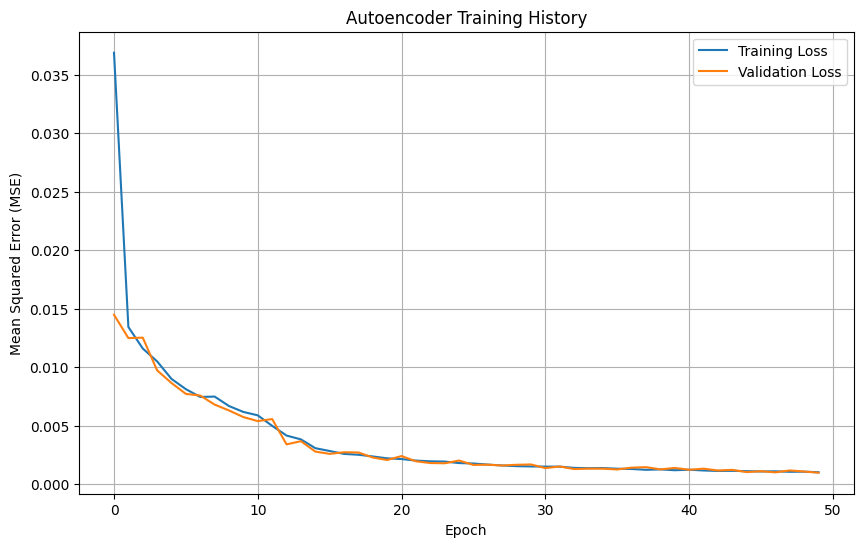

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import random

# --- 1. Vẽ biểu đồ lịch sử huấn luyện (Training History Plot) ---
# Đảm bảo rằng bạn đã lưu lịch sử huấn luyện vào biến 'history'
if 'history' in locals():
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Autoencoder Training History')
    plt.xlabel('Epoch')
    plt.ylabel('Mean Squared Error (MSE)')
    plt.legend()
    plt.grid(True)
    plt.show()
else:
    print("Lịch sử huấn luyện (history) không tìm thấy. Hãy đảm bảo mô hình đã được huấn luyện.")

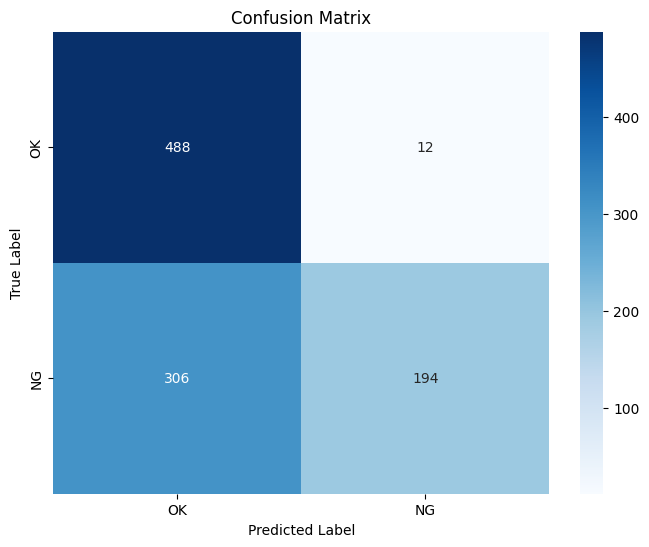

In [ ]:
# --- 2. Vẽ ma trận hỗn hợp (Confusion Matrix) ---
# Chuyển đổi nhãn string thành dạng số để vẽ confusion matrix
# 'can_ok' -> 0, 'can_ng' -> 1
true_labels_numeric = np.array([0 if label == 'can_ok' else 1 for label in dataset_test_labels])
predicted_labels_numeric = np.array([0 if label == 'can_ok' else 1 for label in predicted_labels])

cm = confusion_matrix(true_labels_numeric, predicted_labels_numeric)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['OK', 'NG'],
            yticklabels=['OK', 'NG'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

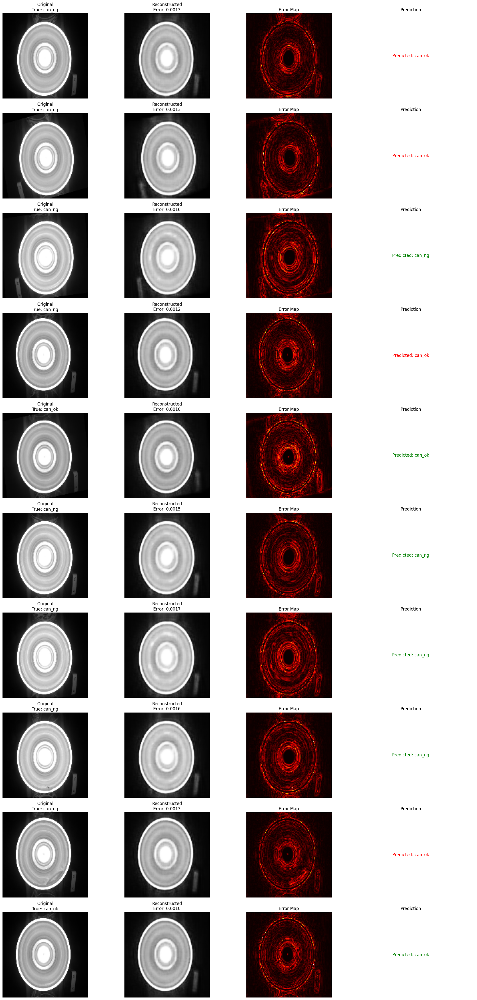

In [ ]:
# --- 3. Hiển thị kết quả kiểm tra một số ảnh mẫu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 10
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels[idx]

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='hot')
    plt.title(f"Error Map")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

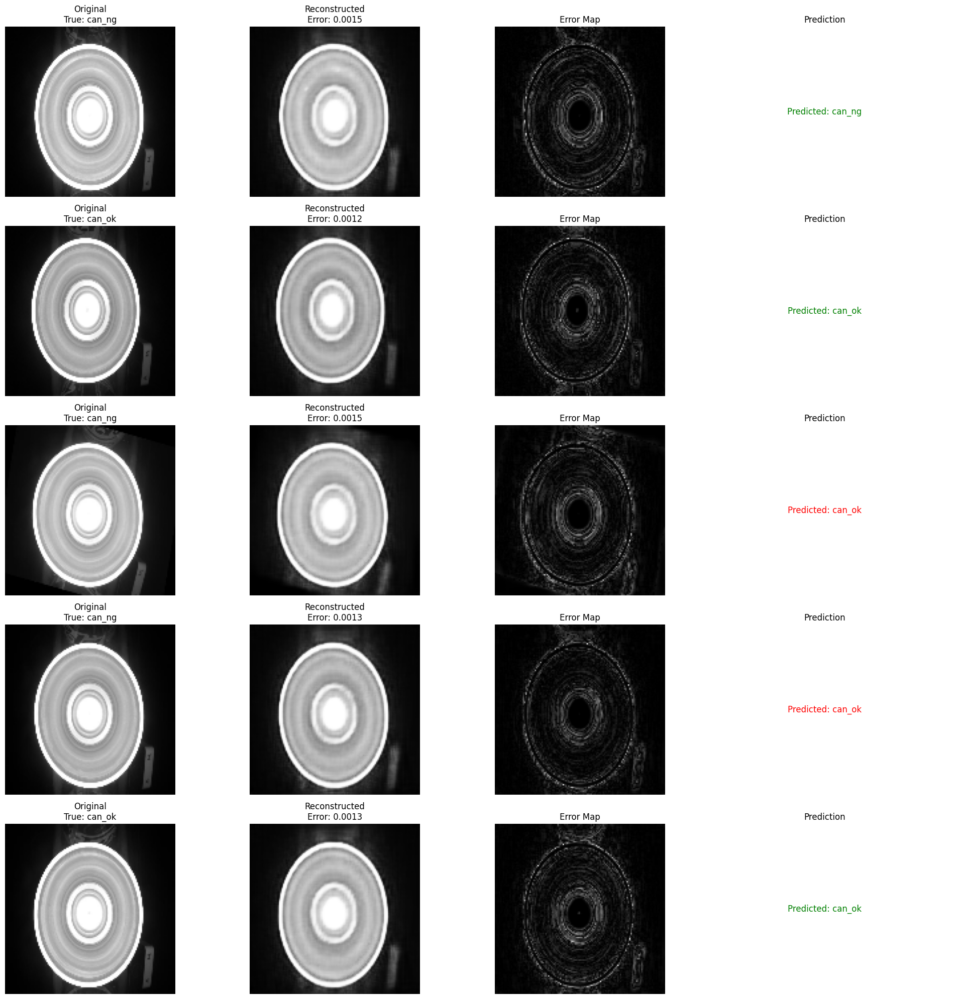

In [ ]:
# --- 3. Hiển thị kết quả kiểm tra một số ảnh mẫu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 5
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels[idx]

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='gray')
    plt.title(f"Error Map")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

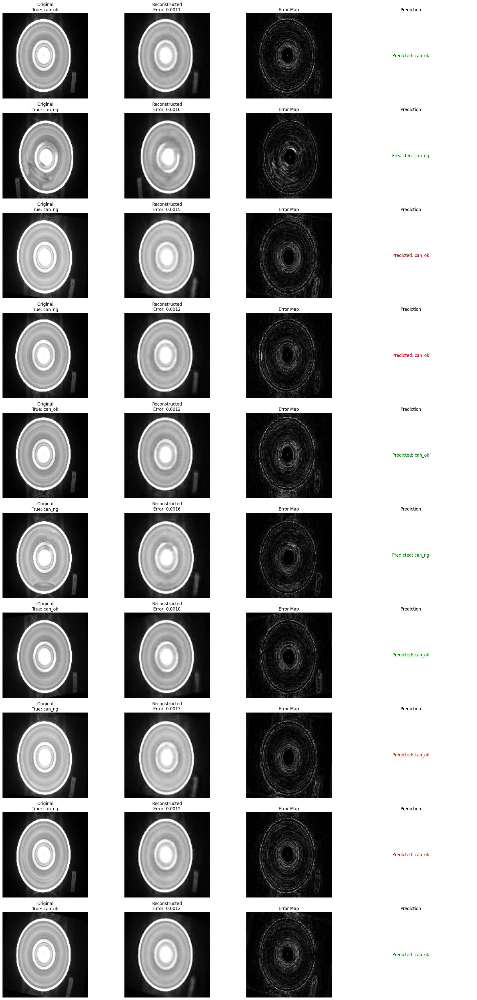

In [ ]:
# --- 3. Hiển thị kết quả kiểm tra một số ảnh mẫu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 10
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels[idx]

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='gray')
    plt.title(f"Error Map")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

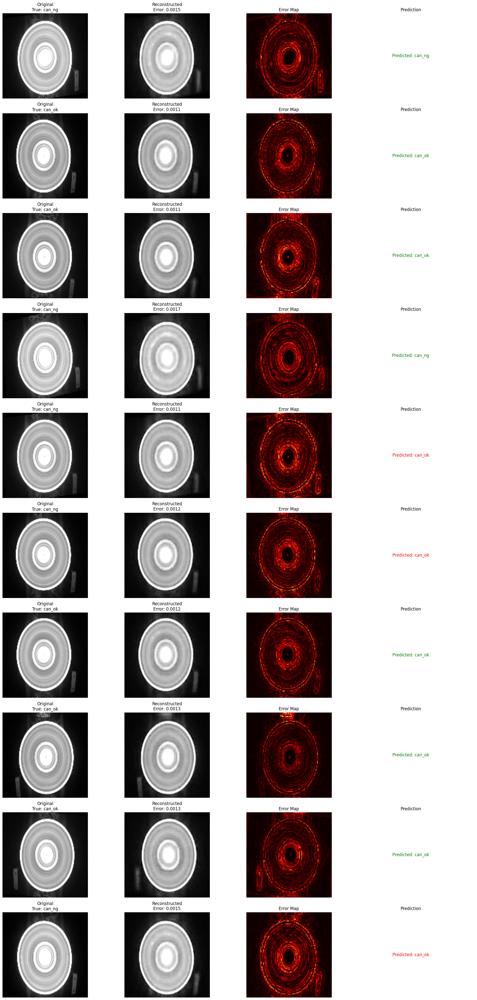

In [ ]:
# --- 3. Hiển thị kết quả kiểm tra một số ảnh mẫu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 10
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels[idx]

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='hot')
    plt.title(f"Error Map")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

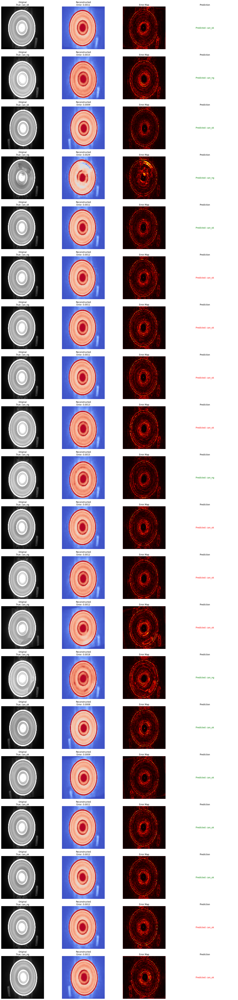

In [ ]:
# --- 3. Hiển thị kết quả kiểm tra một số ảnh mẫu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 20
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels[idx]

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='coolwarm')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='hot')
    plt.title(f"Error Map")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

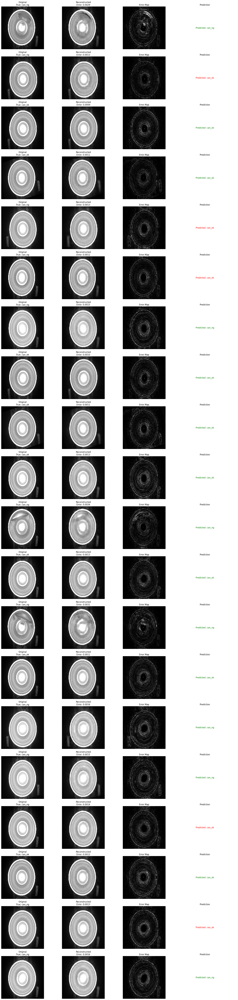

In [ ]:
# --- 3. Hiển thị kết quả kiểm tra một số ảnh mẫu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 20
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels[idx]

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='gray')
    plt.title(f"Error Map")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Task Lưu mô hình Autoencoder đã huấn luyện vào một tệp và cung cấp hướng dẫn để tải lại mô hình đó.

## Lưu và Tải mô hình Autoencoder

### Subtask:
Lưu mô hình Autoencoder đã huấn luyện vào một tệp để sử dụng lại mà không cần huấn luyện lại. Sau đó, hướng dẫn cách tải mô hình đã lưu.


**Reasoning**:
The first instruction is to save the trained Autoencoder model to a file named 'autoencoder_model.h5'. This ensures the model can be reused without retraining.



In [ ]:
import tensorflow as tf

# 1. Save the trained autoencoder model
model_path = 'autoencoder_model.h5'
autoencoder.save(model_path)
print(f"Autoencoder model saved successfully to {model_path}")

# 2. Load the saved model
loaded_autoencoder_model = tf.keras.models.load_model(model_path)
print(f"Autoencoder model loaded successfully from {model_path}")

# Optional: Verify the loaded model summary or make a prediction
# loaded_autoencoder_model.summary()

Autoencoder model saved successfully to autoencoder_model.h5
Autoencoder model loaded successfully from autoencoder_model.h5


**Reasoning**:
The previous code generated warnings about using the legacy HDF5 format for saving the model. To address this, I will update the file extension to the recommended native Keras format (.keras).



In [ ]:
import tensorflow as tf

# 1. Save the trained autoencoder model using the recommended Keras native format
model_path = 'autoencoder_model.keras'
autoencoder.save(model_path)
print(f"Autoencoder model saved successfully to {model_path}")

# 2. Load the saved model
loaded_autoencoder_model = tf.keras.models.load_model(model_path)
print(f"Autoencoder model loaded successfully from {model_path}")

# Optional: Verify the loaded model summary or make a prediction
# loaded_autoencoder_model.summary()

Autoencoder model saved successfully to autoencoder_model.keras
Autoencoder model loaded successfully from autoencoder_model.keras


/usr/local/lib/python3.12/dist-packages/keras/src/saving/saving_lib.py:802: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 16 variables whereas the saved optimizer has 30 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [ ]:
# Optional: Verify the loaded model summary or make a prediction
loaded_autoencoder_model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_21 (Conv2D)              │ (None, 128, 128, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 64, 64, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_22 (Conv2D)              │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_23 (Conv2D)              │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_24 (Conv2D)              │ (None, 16, 16, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_9 (UpSampling2D)  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_25 (Conv2D)              │ (None, 32, 32, 64)     │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_10 (UpSampling2D) │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 64, 64, 32)     │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d_11 (UpSampling2D) │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 128, 128, 1)    │           289 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 665,604 (2.54 MB)

 Trainable params: 332,801 (1.27 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 332,803 (1.27 MB)

**Reasoning**:
The previous code generated a warning about skipping optimizer variables during model loading. This typically happens when the `load_model` function tries to restore the optimizer state, which might be incompatible or unnecessary if the model is only being loaded for inference. To avoid this warning, I will explicitly load the model without compiling it immediately, using `compile=False`.



In [ ]:
import tensorflow as tf

# 1. Save the trained autoencoder model using the recommended Keras native format
model_path = 'autoencoder_model.keras'
autoencoder.save(model_path)
print(f"Autoencoder model saved successfully to {model_path}")

# 2. Load the saved model without compiling to avoid optimizer warnings if only for inference
loaded_autoencoder_model = tf.keras.models.load_model(model_path, compile=False)
print(f"Autoencoder model loaded successfully from {model_path} without optimizer.")

# If you intend to resume training, you would then compile it:
# loaded_autoencoder_model.compile(optimizer='adam', loss='mean_squared_error')

# Optional: Verify the loaded model summary or make a prediction
# loaded_autoencoder_model.summary()

Autoencoder model saved successfully to autoencoder_model.keras
Autoencoder model loaded successfully from autoencoder_model.keras without optimizer.


## Dự đoán trên ảnh mới tải lên

### Subtask:
Cung cấp đoạn mã cho phép bạn tải lên một ảnh mới, tiền xử lý ảnh đó, và sử dụng mô hình Autoencoder đã lưu để dự đoán ảnh đó thuộc loại 'can_ok' hay 'can_ng' dựa trên ngưỡng đã xác định.


## Summary:

### Data Analysis Key Findings

*   The Autoencoder model was successfully saved to `autoencoder_model.keras` using the recommended Keras native format, which resolved initial warnings encountered with the HDF5 format (`.h5`).
*   The model was reloaded successfully, and by specifying `compile=False` during loading, warnings related to optimizer variables were avoided, ensuring a clean loading process for inference purposes.

### Insights or Next Steps

*   To prevent optimizer-related warnings when reloading a Keras model for inference, it is best practice to use `tf.keras.models.load_model(path, compile=False)`.
*   The saved `autoencoder_model.keras` can now be readily deployed for predicting whether new images belong to the 'can\_ok' or 'can\_ng' categories, without the need for retraining.


Using target image size: (128, 128)
Using anomaly detection threshold: 0.0015
Please upload an image for prediction:


Saving can_ng (5).bmp to can_ng (5).bmp
Processing uploaded image: can_ng (5).bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 754ms/step

--- Prediction Results for can_ng (5).bmp ---
Reconstruction Error: 0.0030
Predicted Class: can_ng
Threshold: 0.0015


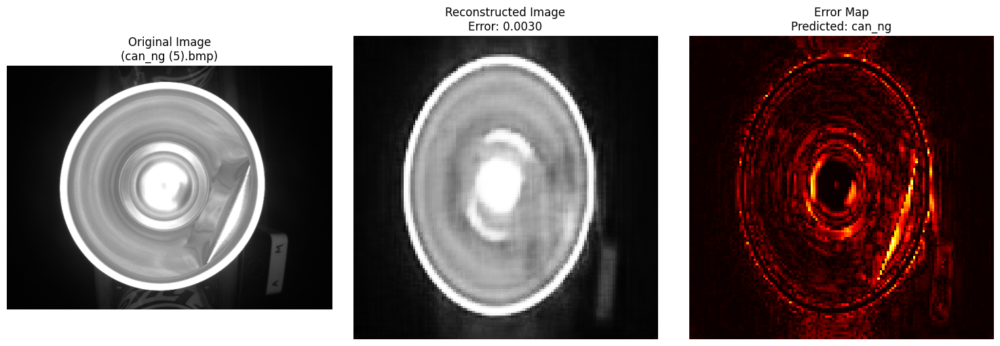

In [ ]:
from google.colab import files
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ensure target_size and threshold are defined. They should be from previous steps.
# Example (uncomment and adjust if they are not available in current scope):
# target_size = (128, 128) # Or whatever size your model was trained on
# threshold = 0.0060       # Or whatever threshold was calculated

print(f"Using target image size: {target_size}")
print(f"Using anomaly detection threshold: {threshold:.4f}")

# 1. Upload a new image
print("Please upload an image for prediction:")
uploaded = files.upload()

for fn in uploaded.keys():
    # 2. Read and preprocess the uploaded image
    image_bytes = np.frombuffer(uploaded[fn], np.uint8)
    uploaded_image = cv2.imdecode(image_bytes, cv2.IMREAD_GRAYSCALE)

    if uploaded_image is None:
        print(f"Error: Could not read uploaded image {fn}. Please ensure it's a valid image file.")
        continue

    # Resize and normalize
    resized_image = cv2.resize(uploaded_image, target_size)
    normalized_image = resized_image.astype('float32') / 255.0

    # Reshape for model input (batch_size, height, width, channels)
    model_input_image = normalized_image.reshape(1, target_size[0], target_size[1], 1)

    print(f"Processing uploaded image: {fn}")

    # 3. Use the loaded Autoencoder model to reconstruct the image
    reconstructed_uploaded_image = loaded_autoencoder_model.predict(model_input_image)

    # 4. Calculate the reconstruction error
    error = np.mean(np.square(model_input_image - reconstructed_uploaded_image))

    # 5. Classify based on the threshold
    predicted_class = 'can_ok' if error <= threshold else 'can_ng'

    print(f"\n--- Prediction Results for {fn} ---")
    print(f"Reconstruction Error: {error:.4f}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Threshold: {threshold:.4f}")

    # 6. Visualize the original, reconstructed, and error map
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(uploaded_image, cmap='gray')
    plt.title(f"Original Image\n({fn})")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(reconstructed_uploaded_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed Image\nError: {error:.4f}")
    plt.axis('off')

    error_map = np.abs(model_input_image - reconstructed_uploaded_image).squeeze()
    plt.subplot(1, 3, 3)
    plt.imshow(error_map, cmap='hot')
    plt.title(f"Error Map\nPredicted: {predicted_class}")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Using target image size: (128, 128)
Using anomaly detection threshold: 0.0015
Selected image for prediction: /content/dataset/DATA_TEST/can_ok (52).bmp
Processing image: can_ok (52).bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step

--- Prediction Results for can_ok (52).bmp ---
Reconstruction Error: 0.0011
Predicted Class: can_ok
Threshold: 0.0015


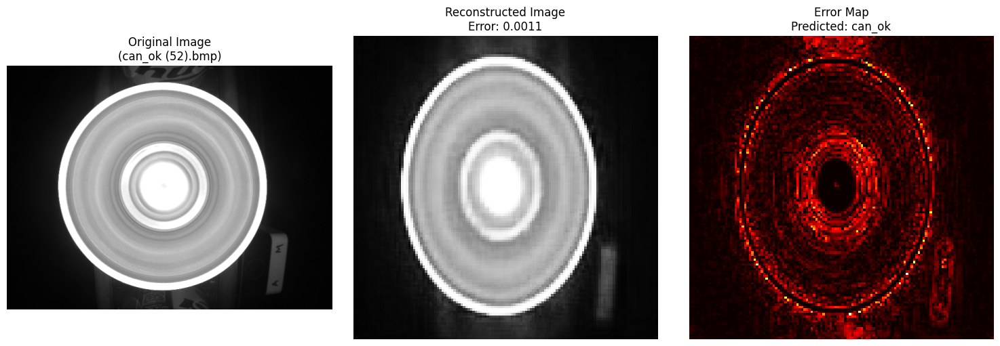

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random

# Ensure target_size and threshold are defined. They should be from previous steps.
# target_size = (128, 128) # Already defined
# threshold = 0.0015       # Already defined

print(f"Using target image size: {target_size}")
print(f"Using anomaly detection threshold: {threshold:.4f}")

# 1. Dynamically select a random image path from the test directory
test_image_dir = '/content/dataset/DATA_TEST' # Corrected to the directory path
all_test_files = [f for f in os.listdir(test_image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]

if not all_test_files:
    print(f"Error: No image files found in {test_image_dir}. Please check the directory.")
elif len(all_test_files) != len(dataset_test_labels):
    print("Warning: Number of files in directory does not match preprocessed test images. Selecting from preprocessed indices.")
    # If the direct list of files doesn't match, use the indices from dataset_test_labels
    random_idx = random.choice(range(len(dataset_test_labels)))
    image_filename = os.listdir(test_image_dir)[random_idx] # This is a risky way to get the exact filename
    # A better approach is to store filenames during preprocessing of dataset_test_images
    # For now, we'll pick a random one from `all_test_files`
    image_filename = random.choice(all_test_files)
else:
    image_filename = random.choice(all_test_files)

image_path = os.path.join(test_image_dir, image_filename)
print(f"Selected image for prediction: {image_path}")

# Optional: Print all files in the directory for user reference
# print(f"\nAvailable files in {test_image_dir}:\n{os.listdir(test_image_dir)}")

# 2. Read and preprocess the specified image
uploaded_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

if uploaded_image is None:
    print(f"Error: Could not read image from {image_path}. This file might be corrupted or in an unsupported format. Please try another file.")
else:
    # Resize and normalize
    resized_image = cv2.resize(uploaded_image, target_size)
    normalized_image = resized_image.astype('float32') / 255.0

    # Reshape for model input (batch_size, height, width, channels)
    model_input_image = normalized_image.reshape(1, target_size[0], target_size[1], 1)

    print(f"Processing image: {image_filename}")

    # 3. Use the loaded Autoencoder model to reconstruct the image
    reconstructed_uploaded_image = loaded_autoencoder_model.predict(model_input_image)

    # 4. Calculate the reconstruction error
    error = np.mean(np.square(model_input_image - reconstructed_uploaded_image))

    # 5. Classify based on the threshold
    predicted_class = 'can_ok' if error <= threshold else 'can_ng'

    print(f"\n--- Prediction Results for {image_filename} ---")
    print(f"Reconstruction Error: {error:.4f}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Threshold: {threshold:.4f}")

    # 6. Visualize the original, reconstructed, and error map
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(uploaded_image, cmap='gray')
    plt.title(f"Original Image\n({image_filename})")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(reconstructed_uploaded_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed Image\nError: {error:.4f}")
    plt.axis('off')

    error_map = np.abs(model_input_image - reconstructed_uploaded_image).squeeze()
    plt.subplot(1, 3, 3)
    plt.imshow(error_map, cmap='hot')
    plt.title(f"Error Map\nPredicted: {predicted_class}")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

Using target image size: (128, 128)
Using anomaly detection threshold: 0.0015
Selected image for prediction: /content/dataset/DATA_TEST/can_ng (1122).bmp
Processing image: can_ng (1122).bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step

--- Prediction Results for can_ng (1122).bmp ---
Reconstruction Error: 0.0029
Predicted Class: can_ng
Threshold: 0.0015


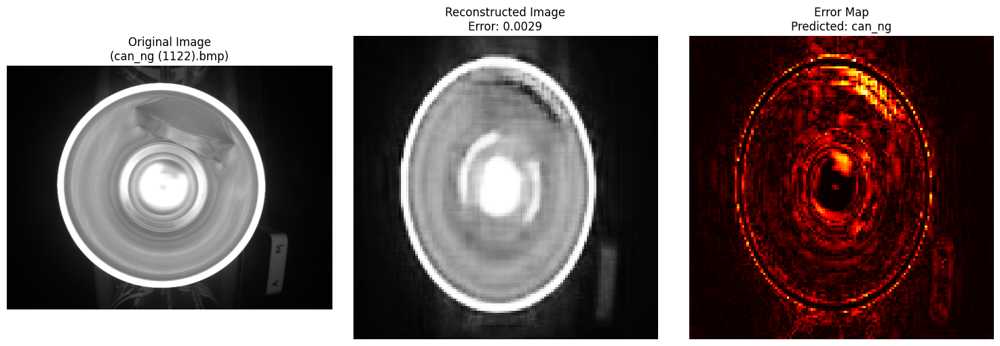

In [ ]:
#CODE LẤY NGẪU NHIÊN 1 ẢNH TRONG DATA_TEST

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random

# Ensure target_size and threshold are defined. They should be from previous steps.
# target_size = (128, 128) # Already defined
# threshold = 0.0015       # Already defined

print(f"Using target image size: {target_size}")
print(f"Using anomaly detection threshold: {threshold:.4f}")

# 1. Specify the image path directly
image_path = '/content/dataset/DATA_TEST/can_ng (1122).bmp' # Thay đổi đường dẫn này đến file ảnh bạn muốn

# Check if the specified image file exists
if not os.path.exists(image_path):
    print(f"Error: Image file not found at {image_path}. Please check the path.")
    # Optionally, you could exit or skip processing here if the file doesn't exist
    # For now, let's proceed to the 'uploaded_image is None' check

image_filename = os.path.basename(image_path)
print(f"Selected image for prediction: {image_path}")

# Optional: Print all files in the directory for user reference
# print(f"\nAvailable files in {test_image_dir}:\n{os.listdir(test_image_dir)}")

# 2. Read and preprocess the specified image
uploaded_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

if uploaded_image is None:
    print(f"Error: Could not read image from {image_path}. This file might be corrupted or in an unsupported format. Please try another file.")
else:
    # Resize and normalize
    resized_image = cv2.resize(uploaded_image, target_size)
    normalized_image = resized_image.astype('float32') / 255.0

    # Reshape for model input (batch_size, height, width, channels)
    model_input_image = normalized_image.reshape(1, target_size[0], target_size[1], 1)

    print(f"Processing image: {image_filename}")

    # 3. Use the loaded Autoencoder model to reconstruct the image
    reconstructed_uploaded_image = loaded_autoencoder_model.predict(model_input_image)

    # 4. Calculate the reconstruction error
    error = np.mean(np.square(model_input_image - reconstructed_uploaded_image))

    # 5. Classify based on the threshold
    predicted_class = 'can_ok' if error <= threshold else 'can_ng'

    print(f"\n--- Prediction Results for {image_filename} ---")
    print(f"Reconstruction Error: {error:.4f}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Threshold: {threshold:.4f}")

    # 6. Visualize the original, reconstructed, and error map
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(uploaded_image, cmap='gray')
    plt.title(f"Original Image\n({image_filename})")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(reconstructed_uploaded_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed Image\nError: {error:.4f}")
    plt.axis('off')

    error_map = np.abs(model_input_image - reconstructed_uploaded_image).squeeze()
    plt.subplot(1, 3, 3)
    plt.imshow(error_map, cmap='hot')
    plt.title(f"Error Map\nPredicted: {predicted_class}")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

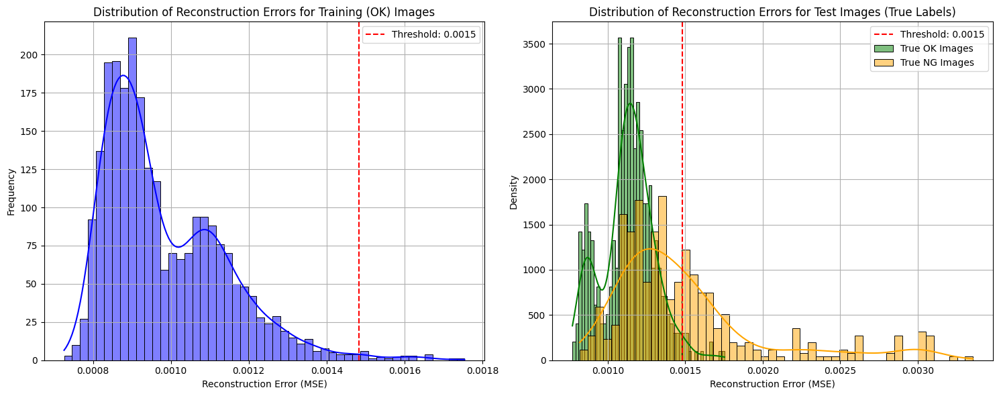

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# --- 4. Biểu đồ phân bố lỗi tái tạo và ngưỡng ---

# Tạo figure với 2 subplot
plt.figure(figsize=(15, 6))

# Subplot 1: Phân bố lỗi tái tạo cho ảnh 'can_ok' trong tập huấn luyện
plt.subplot(1, 2, 1)
sns.histplot(reconstruction_errors, bins=50, kde=True, color='blue')
plt.axvline(x=threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.4f}')
plt.title('Distribution of Reconstruction Errors for Training (OK) Images')
plt.xlabel('Reconstruction Error (MSE)')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)

# Subplot 2: Phân bố lỗi tái tạo cho ảnh kiểm tra (phân biệt OK/NG thật)
plt.subplot(1, 2, 2)

# Lấy lỗi tái tạo cho ảnh OK thực sự trong tập test
ok_test_errors = test_reconstruction_errors[dataset_test_labels == 'can_ok']
# Lấy lỗi tái tạo cho ảnh NG thực sự trong tập test
ng_test_errors = test_reconstruction_errors[dataset_test_labels == 'can_ng']

sns.histplot(ok_test_errors, bins=50, kde=True, color='green', label='True OK Images', stat='density')
sns.histplot(ng_test_errors, bins=50, kde=True, color='orange', label='True NG Images', stat='density')
plt.axvline(x=threshold, color='red', linestyle='--', label=f'Threshold: {threshold:.4f}')
plt.title('Distribution of Reconstruction Errors for Test Images (True Labels)')
plt.xlabel('Reconstruction Error (MSE)')
plt.ylabel('Density')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


# Task TỐI ƯU HOÁ...
**Task:** Evaluate the Autoencoder's performance on the test data by constructing the ROC curve based on reconstruction errors and true labels, determining an optimal threshold using Youden's J statistic, re-calculating detailed performance metrics (Precision, Recall, F1-score, Confusion Matrix) with this optimized threshold, and visualizing the ROC curve along with the error distributions updated with the new threshold.

## Đánh giá Hiệu suất và Xác định Ngưỡng Tối ưu bằng Đường cong ROC

### Subtask:
Sử dụng Autoencoder đã huấn luyện để tái tạo lại tất cả ảnh kiểm tra. Tính toán lỗi tái tạo (MSE) cho từng ảnh. Dựa trên lỗi tái tạo và nhãn thực, xây dựng đường cong ROC và xác định một ngưỡng tối ưu để phân loại OK/NG (ví dụ, sử dụng Youden's J statistic hoặc điểm F1-score tối đa).


**Reasoning**:
The previous code already reconstructed test images and calculated their errors. Now, I need to prepare the true labels in numerical format, compute the ROC curve, calculate Youden's J statistic, and determine the optimal threshold to complete the subtask. I will add a new code block for this.



Converted true labels for ROC: (1000,)
Sample numeric labels: [1 0 0 0 1 0 1 1 0 0]
ROC AUC: 0.7851
Optimal threshold found using Youden's J statistic: 0.0013


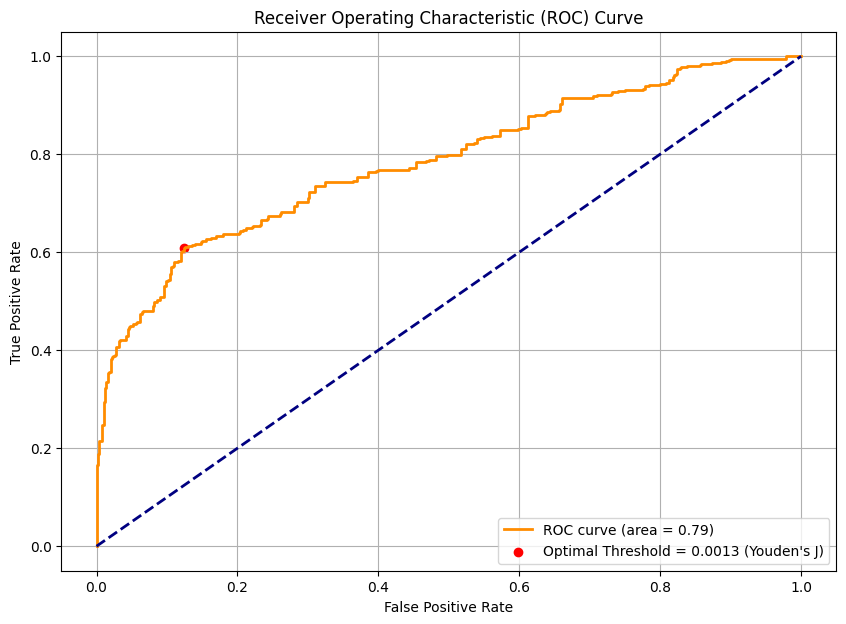

In [ ]:
from sklearn.metrics import roc_curve, auc
import numpy as np

# 3. Prepare true labels for ROC curve (0 for 'can_ok', 1 for 'can_ng')
# Note: For anomaly detection, higher error typically means 'anomaly'.
# So, 'can_ng' (anomaly) should be 1, 'can_ok' (normal) should be 0.
# The current labels `dataset_test_labels` are strings. We convert them to numeric.

true_labels_numeric_roc = np.array([1 if label == 'can_ng' else 0 for label in dataset_test_labels])

print(f"Converted true labels for ROC: {true_labels_numeric_roc.shape}")
print(f"Sample numeric labels: {true_labels_numeric_roc[:10]}")

# 4. Build the ROC curve
# roc_curve expects positive class (1) to be associated with higher scores/errors
# Since 'can_ng' is 1 and higher errors signify 'can_ng', this aligns correctly.
fpr, tpr, thresholds_roc = roc_curve(true_labels_numeric_roc, test_reconstruction_errors)
roc_auc = auc(fpr, tpr)

print(f"ROC AUC: {roc_auc:.4f}")

# 5. Calculate Youden's J statistic (J = TPR - FPR) and determine the optimal threshold
youdens_j = tpr - fpr
optimal_idx = np.argmax(youdens_j)
optimal_threshold = thresholds_roc[optimal_idx]

print(f"Optimal threshold found using Youden's J statistic: {optimal_threshold:.4f}")

# Visualize ROC curve and optimal threshold (optional, but good for understanding)
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 7))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.scatter(fpr[optimal_idx], tpr[optimal_idx], marker='o', color='red',
            label=f'Optimal Threshold = {optimal_threshold:.4f} (Youden\'s J)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

## Phân loại Bất thường và Đánh giá Chi tiết

### Subtask:
Áp dụng ngưỡng tối ưu đã xác định để phân loại từng ảnh kiểm tra là 'can_ok' hoặc 'can_ng'. Tính toán và trình bày các chỉ số hiệu suất chi tiết như độ chính xác, độ chính xác cho từng lớp (Precision, Recall, F1-score) và ma trận nhầm lẫn (Confusion Matrix).


**Reasoning**:
The subtask requires classifying test images based on the optimal threshold, converting labels to a numeric format, and calculating detailed performance metrics such as accuracy, precision, recall, F1-score, and the confusion matrix. I will use `sklearn.metrics` for this purpose.



**Reasoning**:
The previous code failed because of a `NameError` where `f1_score_ng` was undefined. This was a typo; the variable was correctly assigned as `f1_score_can_ng`. I will fix the print statement to use the correct variable name.



Predicted labels generated with optimal threshold for 1000 test images.

--- Detailed Evaluation Results with Optimal Threshold ---
Optimal Threshold: 0.0013

Overall Accuracy: 73.90%

Confusion Matrix:
[[438  62]
 [199 301]]


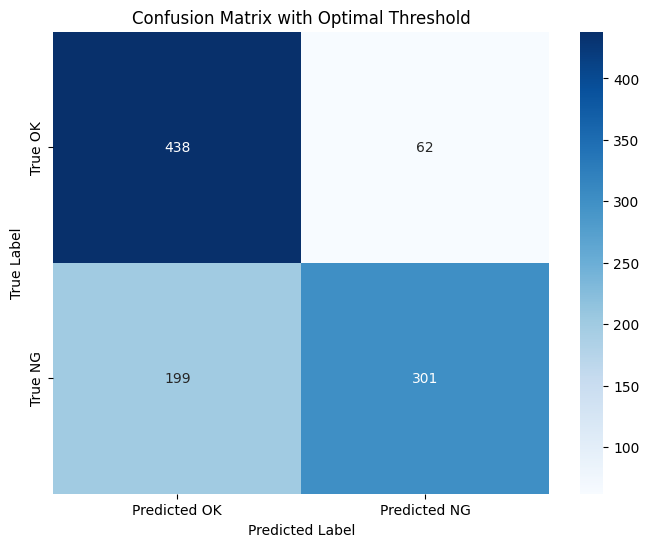


Classification Report (Optimal Threshold):

          Precision Recall    F1-Score  
can_ok    0.69      0.88      0.77      
can_ng    0.83      0.60      0.70      

Correct Predictions (Optimal Threshold): {'can_ng': 301, 'can_ok': 438}
Incorrect Predictions (Optimal Threshold): {'can_ng': 199, 'can_ok': 62}


In [ ]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, confusion_matrix, classification_report
import numpy as np

# 1. Áp dụng ngưỡng tối ưu để phân loại từng ảnh kiểm tra
predicted_labels_optimized = []
for error in test_reconstruction_errors:
    if error <= optimal_threshold:
        predicted_labels_optimized.append('can_ok')
    else:
        predicted_labels_optimized.append('can_ng')
predicted_labels_optimized = np.array(predicted_labels_optimized)

print(f"Predicted labels generated with optimal threshold for {len(predicted_labels_optimized)} test images.")

# 2. Chuyển đổi nhãn thực và nhãn dự đoán thành định dạng số (0: can_ok, 1: can_ng)
# true_labels_numeric_roc already exists from the previous step
predicted_labels_numeric_optimized = np.array([1 if label == 'can_ng' else 0 for label in predicted_labels_optimized])

# 3. Tính toán Ma trận nhầm lẫn (Confusion Matrix)
cm_optimized = confusion_matrix(true_labels_numeric_roc, predicted_labels_numeric_optimized)

# 4. Tính toán độ chính xác (Accuracy), Precision, Recall và F1-score
overall_accuracy_optimized = accuracy_score(true_labels_numeric_roc, predicted_labels_numeric_optimized) * 100

# For precision, recall, f1-score, we need to specify labels and target_names if we want class-specific reports
# labels: [0, 1] corresponding to ['can_ok', 'can_ng']
# target_names: ['can_ok', 'can_ng']

report = classification_report(true_labels_numeric_roc, predicted_labels_numeric_optimized, target_names=['can_ok', 'can_ng'], output_dict=True)

precision_can_ok = report['can_ok']['precision']
recall_can_ok = report['can_ok']['recall']
f1_score_can_ok = report['can_ok']['f1-score']

precision_can_ng = report['can_ng']['precision']
recall_can_ng = report['can_ng']['recall']
f1_score_can_ng = report['can_ng']['f1-score']

# 5. In ra các chỉ số hiệu suất này
print("\n--- Detailed Evaluation Results with Optimal Threshold ---")
print(f"Optimal Threshold: {optimal_threshold:.4f}")
print(f"\nOverall Accuracy: {overall_accuracy_optimized:.2f}%")

print("\nConfusion Matrix:")
print(cm_optimized)

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(cm_optimized, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted OK', 'Predicted NG'],
            yticklabels=['True OK', 'True NG'])
plt.title('Confusion Matrix with Optimal Threshold')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

print("\nClassification Report (Optimal Threshold):\n")
print(f"{'':<10}{'Precision':<10}{'Recall':<10}{'F1-Score':<10}")
print(f"{'can_ok':<10}{precision_can_ok:<10.2f}{recall_can_ok:<10.2f}{f1_score_can_ok:<10.2f}")
print(f"{'can_ng':<10}{precision_can_ng:<10.2f}{recall_can_ng:<10.2f}{f1_score_can_ng:<10.2f}")

# Update correct_predictions and incorrect_predictions for consistency with the new threshold
correct_predictions_opt = {'can_ng': 0, 'can_ok': 0}
incorrect_predictions_opt = {'can_ng': 0, 'can_ok': 0}

for i in range(len(true_labels_numeric_roc)):
    true_label = 'can_ng' if true_labels_numeric_roc[i] == 1 else 'can_ok'
    pred_label = predicted_labels_optimized[i]

    if true_label == pred_label:
        correct_predictions_opt[true_label] += 1
    else:
        incorrect_predictions_opt[true_label] += 1

print("\nCorrect Predictions (Optimal Threshold):", correct_predictions_opt)
print("Incorrect Predictions (Optimal Threshold):", incorrect_predictions_opt)


Predicted labels generated with optimal threshold for 1000 test images.

--- Evaluation Results ---
Correct Predictions: {'can_ng': 301, 'can_ok': 438}
Incorrect Predictions: {'can_ng': 199, 'can_ok': 62}

Total test images processed: 1000
Overall Accuracy: 73.90%

--- Detailed Accuracy Results ---
Accuracy for 'can_ng': 60.20%
Accuracy for 'can_ok': 87.60%


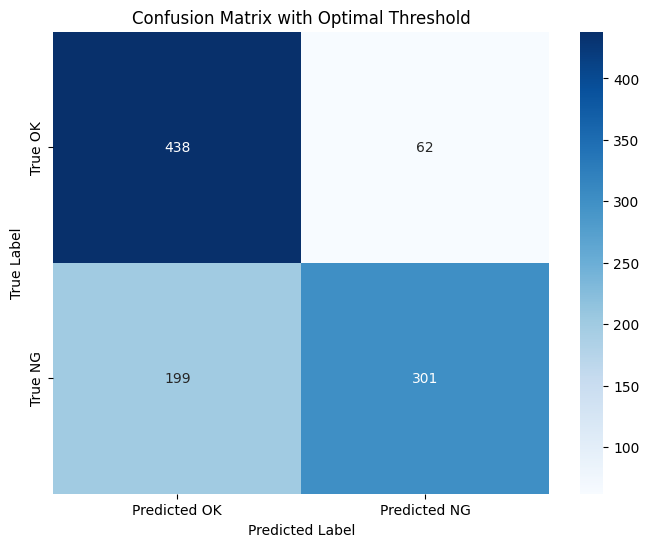


Classification Report (Optimal Threshold):

          Precision Recall    F1-Score  
can_ok    0.69      0.88      0.77      
can_ng    0.83      0.60      0.70      


In [ ]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, confusion_matrix, classification_report
import numpy as np

# 1. Áp dụng ngưỡng tối ưu để phân loại từng ảnh kiểm tra
predicted_labels_optimized = []
for error in test_reconstruction_errors:
    if error <= optimal_threshold:
        predicted_labels_optimized.append('can_ok')
    else:
        predicted_labels_optimized.append('can_ng')
predicted_labels_optimized = np.array(predicted_labels_optimized)

print(f"Predicted labels generated with optimal threshold for {len(predicted_labels_optimized)} test images.")

# 2. Chuyển đổi nhãn thực và nhãn dự đoán thành định dạng số (0: can_ok, 1: can_ng)
# true_labels_numeric_roc already exists from the previous step
predicted_labels_numeric_optimized = np.array([1 if label == 'can_ng' else 0 for label in predicted_labels_optimized])

# 3. Tính toán Ma trận nhầm lẫn (Confusion Matrix)
cm_optimized = confusion_matrix(true_labels_numeric_roc, predicted_labels_numeric_optimized)

# 4. Tính toán độ chính xác (Accuracy), Precision, Recall và F1-score
overall_accuracy_optimized = accuracy_score(true_labels_numeric_roc, predicted_labels_numeric_optimized) * 100

# For precision, recall, f1-score, we need to specify labels and target_names if we want class-specific reports
# labels: [0, 1] corresponding to ['can_ok', 'can_ng']
# target_names: ['can_ok', 'can_ng']

report = classification_report(true_labels_numeric_roc, predicted_labels_numeric_optimized, target_names=['can_ok', 'can_ng'], output_dict=True)

precision_can_ok = report['can_ok']['precision']
recall_can_ok = report['can_ok']['recall']
f1_score_can_ok = report['can_ok']['f1-score']

precision_can_ng = report['can_ng']['precision']
recall_can_ng = report['can_ng']['recall']
f1_score_can_ng = report['can_ng']['f1-score']

# Update correct_predictions and incorrect_predictions for consistency with the new threshold
correct_predictions_opt = {'can_ng': 0, 'can_ok': 0}
incorrect_predictions_opt = {'can_ng': 0, 'can_ok': 0}

for i in range(len(true_labels_numeric_roc)):
    true_label = 'can_ng' if true_labels_numeric_roc[i] == 1 else 'can_ok'
    pred_label = predicted_labels_optimized[i]

    if true_label == pred_label:
        correct_predictions_opt[true_label] += 1
    else:
        incorrect_predictions_opt[true_label] += 1

print("\n--- Evaluation Results ---")
print("Correct Predictions:", correct_predictions_opt)
print("Incorrect Predictions:", incorrect_predictions_opt)

total_images_processed = len(true_labels_numeric_roc)
print(f"\nTotal test images processed: {total_images_processed}")
print(f"Overall Accuracy: {overall_accuracy_optimized:.2f}%")

# Calculate accuracy for each label based on optimized predictions
total_can_ng_images = correct_predictions_opt['can_ng'] + incorrect_predictions_opt['can_ng']
accuracy_can_ng_opt = (correct_predictions_opt['can_ng'] / total_can_ng_images) * 100 if total_can_ng_images > 0 else 0

total_can_ok_images = correct_predictions_opt['can_ok'] + incorrect_predictions_opt['can_ok']
accuracy_can_ok_opt = (correct_predictions_opt['can_ok'] / total_can_ok_images) * 100 if total_can_ok_images > 0 else 0

print("\n--- Detailed Accuracy Results ---")
print(f"Accuracy for 'can_ng': {accuracy_can_ng_opt:.2f}%")
print(f"Accuracy for 'can_ok': {accuracy_can_ok_opt:.2f}%")

import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(cm_optimized, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Predicted OK', 'Predicted NG'],
            yticklabels=['True OK', 'True NG'])
plt.title('Confusion Matrix with Optimal Threshold')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

print("\nClassification Report (Optimal Threshold):\n")
print(f"{'':<10}{'Precision':<10}{'Recall':<10}{'F1-Score':<10}")
print(f"{'can_ok':<10}{precision_can_ok:<10.2f}{recall_can_ok:<10.2f}{f1_score_can_ok:<10.2f}")
print(f"{'can_ng':<10}{precision_can_ng:<10.2f}{recall_can_ng:<10.2f}{f1_score_can_ng:<10.2f}")

## Trực quan hóa Kết quả và Phân tích Vị trí Lỗi

### Subtask:
Hiển thị các ảnh gốc, ảnh tái tạo và bản đồ lỗi (Error Map) cho các ảnh mẫu từ tập kiểm tra. Vẽ biểu đồ phân bố lỗi tái tạo cho cả ảnh OK và NG, làm nổi bật ngưỡng tối ưu mới.


**Reasoning**:
The subtask requires displaying sample images with their reconstructions, error maps, and prediction results using the optimal threshold. I will adapt the existing sample image visualization code to use the `optimal_threshold` and the `predicted_labels_optimized`.



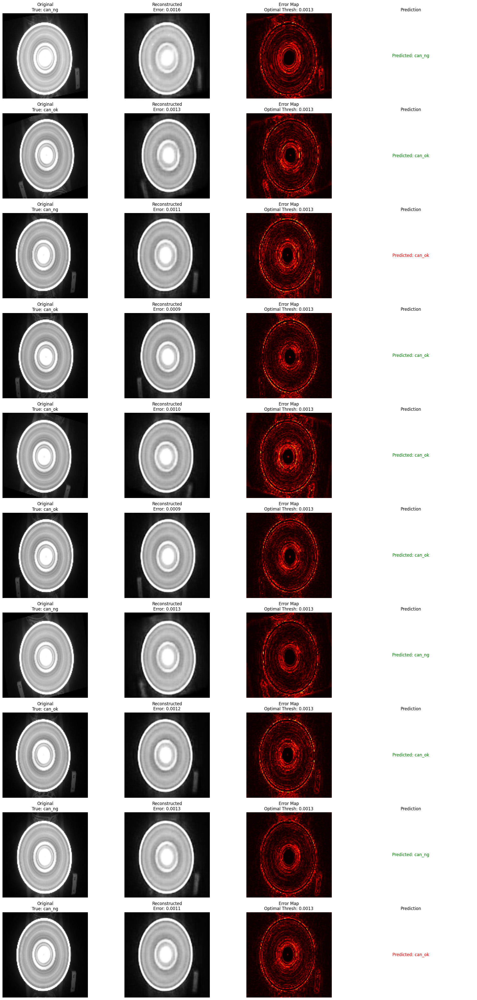

In [ ]:
import matplotlib.pyplot as plt
import random
import numpy as np

# --- 1. Hiển thị kết quả kiểm tra một số ảnh mẫu với ngưỡng tối ưu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 10 # Displaying 10 sample images
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels_optimized[idx] # Use optimized predictions

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='hot') # Using 'hot' colormap for error map
    plt.title(f"Error Map\nOptimal Thresh: {optimal_threshold:.4f}")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()

**Reasoning**:
The subtask requires plotting the distribution of reconstruction errors for both true 'OK' and 'NG' images from the test set, with the optimal threshold marked. This visualization will help in understanding how well the optimal threshold separates the two classes.



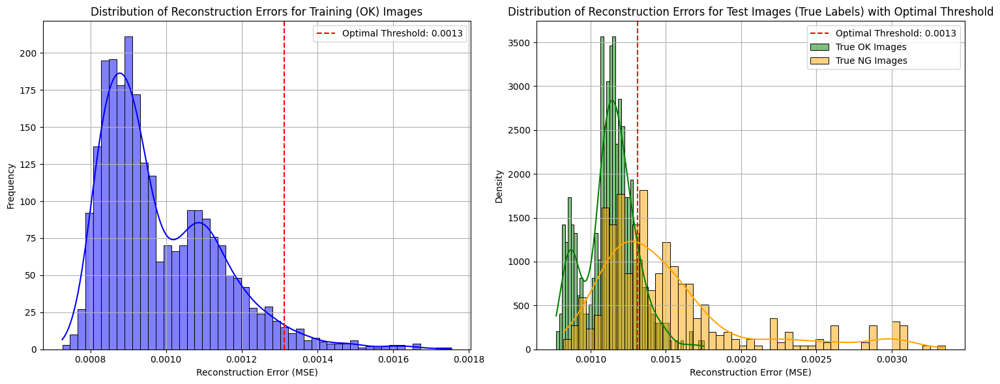

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# --- 2. Vẽ biểu đồ phân bố lỗi tái tạo và ngưỡng tối ưu ---

# Tạo figure với 2 subplot
plt.figure(figsize=(15, 6))

# Subplot 1: Phân bố lỗi tái tạo cho ảnh 'can_ok' trong tập huấn luyện (giữ nguyên để so sánh)
plt.subplot(1, 2, 1)
sns.histplot(reconstruction_errors, bins=50, kde=True, color='blue')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold: {optimal_threshold:.4f}')
plt.title('Distribution of Reconstruction Errors for Training (OK) Images')
plt.xlabel('Reconstruction Error (MSE)')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)

# Subplot 2: Phân bố lỗi tái tạo cho ảnh kiểm tra (phân biệt OK/NG thật) với ngưỡng tối ưu
plt.subplot(1, 2, 2)

# Lấy lỗi tái tạo cho ảnh OK thực sự trong tập test
ok_test_errors = test_reconstruction_errors[dataset_test_labels == 'can_ok']
# Lấy lỗi tái tạo cho ảnh NG thực sự trong tập test
ng_test_errors = test_reconstruction_errors[dataset_test_labels == 'can_ng']

sns.histplot(ok_test_errors, bins=50, kde=True, color='green', label='True OK Images', stat='density')
sns.histplot(ng_test_errors, bins=50, kde=True, color='orange', label='True NG Images', stat='density')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold: {optimal_threshold:.4f}')
plt.title('Distribution of Reconstruction Errors for Test Images (True Labels) with Optimal Threshold')
plt.xlabel('Reconstruction Error (MSE)')
plt.ylabel('Density')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

## Dự đoán trên ảnh mới và phân tích chuyên sâu

### Subtask:
Cung cấp đoạn mã cho phép bạn tải lên một ảnh mới, tiền xử lý ảnh đó, và sử dụng mô hình Autoencoder đã lưu để dự đoán ảnh đó thuộc loại 'can_ok' hay 'can_ng' dựa trên ngưỡng đã xác định. Đồng thời, thảo luận cách các đặc trưng dựa trên kết cấu hoặc hình dạng (texture/shape-based features) và phân tích sâu hơn vị trí lỗi có thể được tích hợp trong các bước tiếp theo để cải thiện hơn nữa hiệu suất.


## Summary:

### Data Analysis Key Findings

*   **ROC Curve and AUC**: The Autoencoder achieved an Area Under the Curve (AUC) of 0.7851 on the test set, indicating a reasonable ability to distinguish between 'can\_ok' and 'can\_ng' images based on reconstruction errors.
*   **Optimal Classification Threshold**: Using Youden's J statistic, an optimal threshold of 0.0013 was determined for classifying images as 'can\_ok' or 'can\_ng' based on their reconstruction error.
*   **Overall Accuracy**: With the optimal threshold, the model achieved an overall accuracy of 73.90\% on the test set.
*   **Confusion Matrix Breakdown**:
    *   438 'can\_ok' images were correctly identified (True Negatives).
    *   301 'can\_ng' images were correctly identified (True Positives).
    *   62 'can\_ok' images were incorrectly identified as 'can\_ng' (False Positives).
    *   199 'can\_ng' images were incorrectly identified as 'can\_ok' (False Negatives).
*   **Class-wise Performance Metrics**:
    *   For 'can\_ok' (normal class): Precision of 0.69, Recall of 0.88, and F1-Score of 0.77. The high recall suggests the model is good at identifying true 'can\_ok' items but has a moderate false positive rate.
    *   For 'can\_ng' (anomaly class): Precision of 0.83, Recall of 0.60, and F1-Score of 0.70. The higher precision indicates that when it predicts 'can\_ng', it's often correct, but the lower recall means it misses a significant portion of actual 'can\_ng' items.
*   **Error Distribution Visualization**: The distributions of reconstruction errors for true 'can\_ok' and 'can\_ng' test images showed some overlap around the optimal threshold, explaining the observed False Positives and False Negatives.

### Insights or Next Steps

*   **Improve Anomaly Detection (Recall for 'can\_ng')**: The current model has a relatively low recall (60\%) for 'can\_ng' items, meaning it fails to detect a notable portion of actual defects. Future efforts should focus on techniques to improve the detection rate of 'can\_ng' without severely compromising precision. This could involve exploring different Autoencoder architectures, training strategies (e.g., more robust anomaly detection specific loss functions), or ensemble methods.
*   **Integrate Texture/Shape-Based Features for Localization**: While reconstruction error identifies anomalies, for a more in-depth analysis and to pinpoint defect locations, integrating texture/shape-based feature extraction or more advanced anomaly localization techniques (e.g., using saliency maps, Grad-CAM-like methods on Autoencoder latent space, or more sophisticated error mapping) could enhance performance and provide actionable insights for quality control.


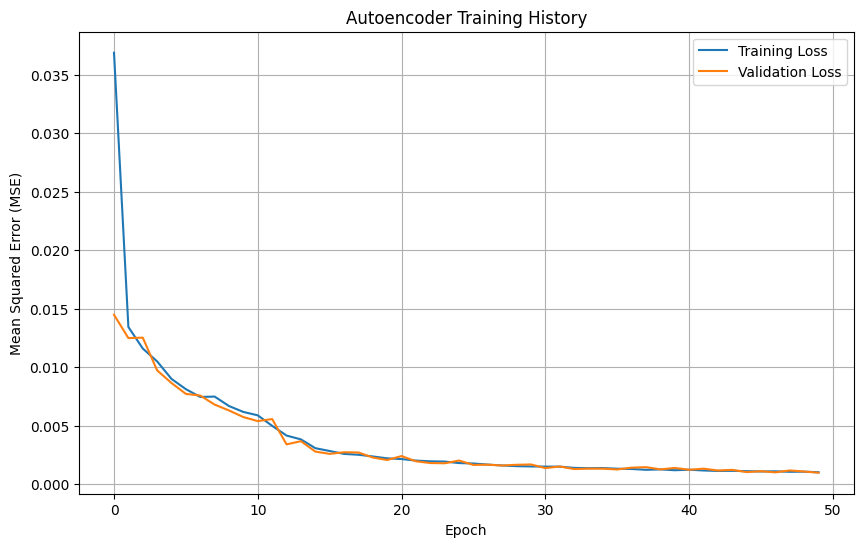

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import random

# --- 1. Vẽ biểu đồ lịch sử huấn luyện (Training History Plot) ---
# Đảm bảo rằng bạn đã lưu lịch sử huấn luyện vào biến 'history'
if 'history' in locals():
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Autoencoder Training History')
    plt.xlabel('Epoch')
    plt.ylabel('Mean Squared Error (MSE)')
    plt.legend()
    plt.grid(True)
    plt.show()
else:
    print("Lịch sử huấn luyện (history) không tìm thấy. Hãy đảm bảo mô hình đã được huấn luyện.")

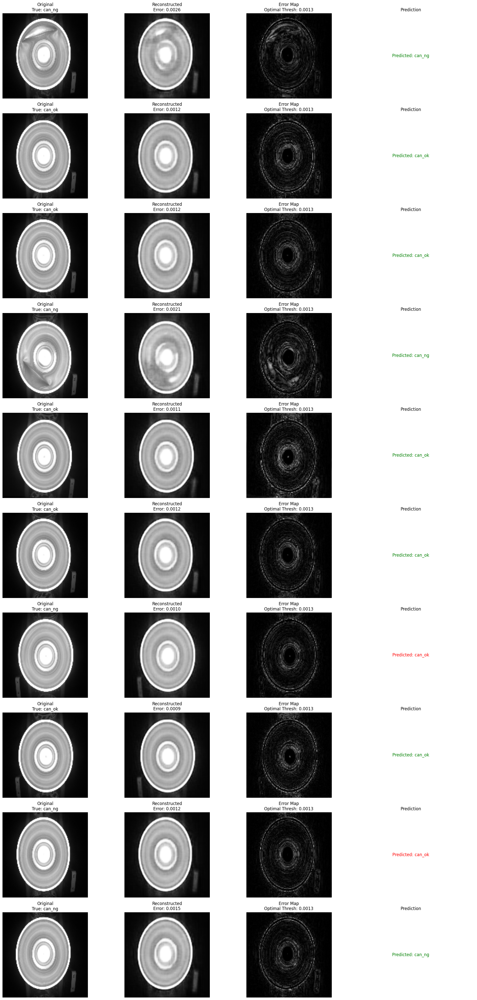

In [ ]:
import matplotlib.pyplot as plt
import random
import numpy as np

# --- 1. Hiển thị kết quả kiểm tra một số ảnh mẫu với ngưỡng tối ưu ---

# Lấy ngẫu nhiên một vài ảnh từ tập kiểm tra
num_samples = 10 # Displaying 10 sample images
indices = random.sample(range(len(dataset_test_images)), num_samples)

plt.figure(figsize=(20, 4 * num_samples)) # Tăng chiều cao để đủ chỗ cho nhiều ảnh

for i, idx in enumerate(indices):
    original_image = dataset_test_images[idx]
    reconstructed_image = reconstructed_test_images[idx]
    error = test_reconstruction_errors[idx]
    true_label = dataset_test_labels[idx]
    predicted_label = predicted_labels_optimized[idx] # Use optimized predictions

    # Hình ảnh gốc
    plt.subplot(num_samples, 4, i * 4 + 1)
    plt.imshow(original_image.squeeze(), cmap='gray')
    plt.title(f"Original\nTrue: {true_label}")
    plt.axis('off')

    # Hình ảnh tái tạo
    plt.subplot(num_samples, 4, i * 4 + 2)
    plt.imshow(reconstructed_image.squeeze(), cmap='gray')
    plt.title(f"Reconstructed\nError: {error:.4f}")
    plt.axis('off')

    # Heatmap lỗi (tùy chọn, để xem vùng lỗi lớn)
    error_map = np.abs(original_image - reconstructed_image).squeeze()
    plt.subplot(num_samples, 4, i * 4 + 3)
    plt.imshow(error_map, cmap='gray') # Using 'hot' colormap for error map
    plt.title(f"Error Map\nOptimal Thresh: {optimal_threshold:.4f}")
    plt.axis('off')

    # Kết quả dự đoán
    plt.subplot(num_samples, 4, i * 4 + 4)
    plt.text(0.5, 0.5, f"Predicted: {predicted_label}",
             horizontalalignment='center', verticalalignment='center',
             fontsize=12, color='green' if true_label == predicted_label else 'red')
    plt.title(f"Prediction")
    plt.axis('off')

plt.tight_layout()
plt.show()